In [2]:
from PIL import Image
import os
import pickle
from glob import glob
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2
import math

In [3]:
# Função para mostrar várias imagens em forma de uma grade
def image_grid(images, cols = 4):
    n_images = len(images)
    fig = plt.figure()
    for n, (image) in enumerate(images):
        a = fig.add_subplot(int(cols), int(np.ceil(n_images/float(cols))), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [4]:
# https://github.com/sunnyshah2894/DigitalHairRemoval

def remove_hairs(img):
    kernel = cv2.getStructuringElement(1,(17,17))
    grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
    edges = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    ret,thresh = cv2.threshold(edges,10,255,cv2.THRESH_BINARY)
    dst = cv2.inpaint(img,thresh,1,cv2.INPAINT_TELEA)
    
    return edges, thresh, dst

In [5]:
# Função para aplicar um equalizador de histograma adaptativo (CLAHE)
def adaptive_histeq(img_gray):
      clahe = cv2.createCLAHE(clipLimit = 2.0, tileGridSize=(8,8))
      final_img = clahe.apply(img_gray) 
      return final_img

In [6]:
def lesion_segmentation1(img):
    
    #img = remove_hairs(img)
    
    R, G, B = cv2.split(img)
    norm_img = np.zeros((800,800))
    r_norm = cv2.normalize(R,  norm_img, 0, 255, cv2.NORM_MINMAX)

    blur = cv2.GaussianBlur(r_norm,(13,13),0)
    imgeq=adaptive_histeq(blur)
    
    T,imgt = cv2.threshold(imgeq,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    final_img = cv2.bitwise_not(imgt)
    
    kernel = np.ones((7,7),np.uint8)
    closing = cv2.morphologyEx(final_img, cv2.MORPH_CLOSE, kernel)
    
    
    return closing

In [8]:
def simple_score(lesion, mask):
#     print(lesion)
#     print(mask)
    if mask.shape != lesion.shape:
        raise Exception(f"Image dimensions do not match. Image1: {mask.shape} x Image2: {lesion.shape}")
    TP=0
    FP=0
    TN=0
    FN = 0
    linhas,colunas=mask.shape
    for l in range(linhas):
      for c in range(colunas):
        if mask[l][c] == lesion[l][c] and mask[l][c]==255:
            TP+=1
        elif mask[l][c] == lesion[l][c] and mask[l][c]==0:
            TN+=1
        elif mask[l][c]==255:
            FP+=1
        else:
            FN+=1
            
    return TP,TN, FP, FN

In [10]:
def pixel_accuracy(TP,TN,FP,FN):
    return (TP+TN)/(TP+TN+FP+FN)

In [11]:
def jaccards_index(TP,TN,FP,FN):
    return TP/(TP+FP+FN)

In [12]:
def dice_coefficient(TP,TN,FP,FN):
    return 2*TP/(2*TP+FP+FN)

In [13]:
def compare_images(masks_path, lesions_path, segmentation_func):
    results_list = []

    #print("start")
    for f in os.listdir(lesions_path):
            if f.endswith(".jpg"):
#                 #print(f)
                try:
                    lesion = lesions_path+f
                    lesion_img = cv2.imread(lesion)[:,:,::-1]
                    mask = masks_path+f[:-4]+"_segmentation"+".png"
                    mask_img = cv2.imread(mask, cv2.IMREAD_UNCHANGED)

                    segmented_lesion = segmentation_func(lesion_img)
                                        
                    TP, TN, FP, FN = simple_score(segmented_lesion,mask_img)
                    
#                     print(TP,TN, FP, FN)

                    score = ( pixel_accuracy(TP,TN,FP,FN), jaccards_index(TP,TN,FP,FN), dice_coefficient(TP,TN,FP,FN) )
                    
                    print(score)

                    results_list.append( (score, segmented_lesion, mask_img) )
 
                    #print(score)
                    
                except AttributeError:
                    #print("Lesion image has no corresponding mask")
                    pass
    return results_list

In [14]:
LESIONS_PATH = '../../../ISIC/Lesions/'
MASKS_PATH = '../../../ISIC/Masks/'

In [15]:
results = compare_images(MASKS_PATH, LESIONS_PATH,  lesion_segmentation1)

(0.5798381195759266, 0.029392815203113744, 0.05710709219845123)
(0.6540738031914893, 0.014132666958797684, 0.02787143619222724)
(0.7143160502115885, 0.1448206822524532, 0.2530015128090037)
(0.9347139994303385, 0.5873014597132017, 0.7399998987203313)
(0.7538032531738281, 0.2691022751724216, 0.4240828819503315)
(0.7747027079264323, 0.27510504330607183, 0.4315017727367526)
(0.40593719482421875, 0.3387672954550601, 0.5060883943089001)
(0.9422480265299479, 0.7732252169484417, 0.8721116861614359)
(0.9474323510522215, 0.8009378182880416, 0.8894674876108796)
(0.9144105132774746, 0.5013896554771236, 0.6679007726582317)
(0.9252897516812459, 0.718775234365965, 0.8363807204042154)
(0.510396049283345, 0.31367419171470995, 0.4775524916193687)
(0.7456467665874764, 0.30740120287817435, 0.4702476978014811)
(0.8374644219569225, 0.3770422512357017, 0.5476117394326272)
(0.9179307127089108, 0.774129877351816, 0.8726868164886932)
(0.8984819136095276, 0.4399336714127771, 0.6110471338324083)
(0.93319913813440

In [16]:
scores_px = [r[0][0] for r in results]
scores_jaccard = [r[0][1] for r in results]
scores_dice = [r[0][2] for r in results]

processed = [r[1] for r in results]
answers = [r[2] for r in results]

In [17]:
pixel_accuracy_score = sum(scores_px)/len(scores_px)
dice_coefficient_score = sum(scores_jaccard)/len(scores_jaccard)
jaccards_index_score = sum(scores_dice)/len(scores_dice)

print("Score pixel accuracy: ", pixel_accuracy_score)
print("Score jaccards index: ", jaccards_index_score)
print("Score dice coefficient: ", dice_coefficient_score)

Score pixel accuracy:  0.7198353649584267
Score jaccards index:  0.4581088824637623
Score dice coefficient:  0.33244900399683563


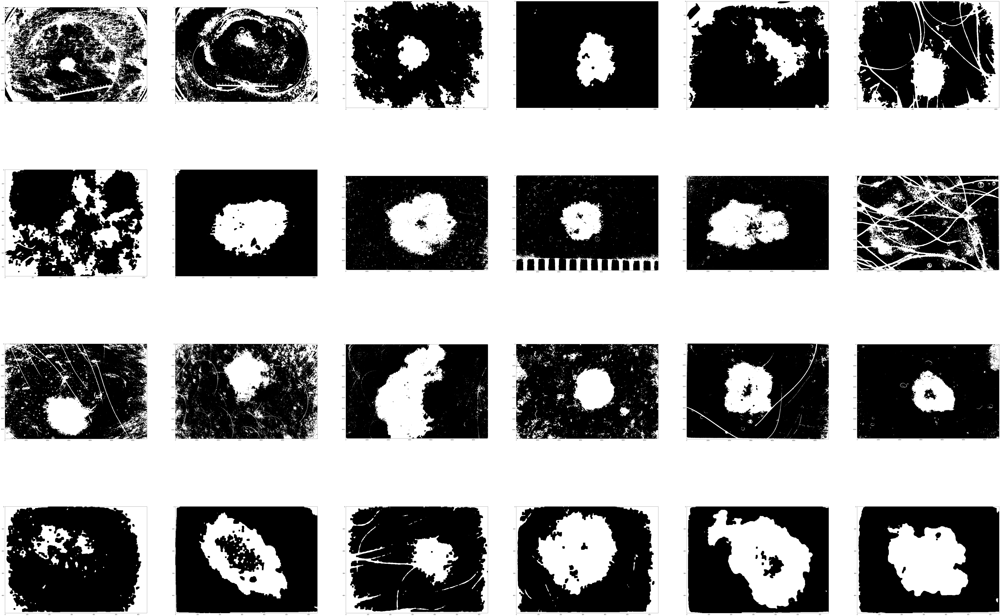

In [18]:
image_grid(processed[:24], cols = 4)

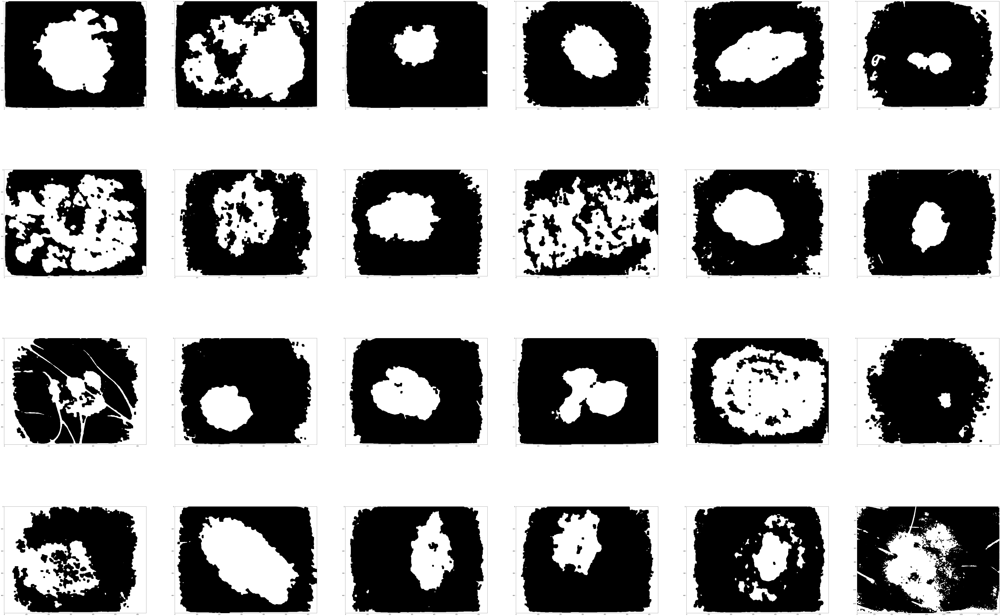

In [19]:
image_grid(processed[24:48], cols = 4)

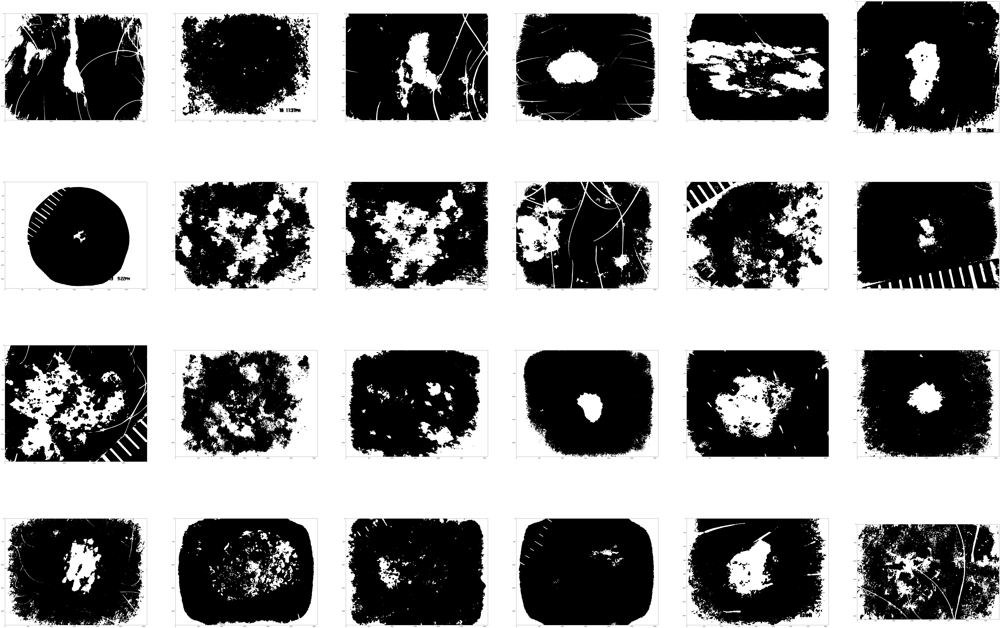

In [20]:
image_grid(processed[48:72], cols = 4)

In [21]:
image_grid(processed[72:], cols = 4)

## References
https://www.jeremyjordan.me/evaluating-image-segmentation-models/


https://towardsdatascience.com/how-accurate-is-image-segmentation-dd448f896388